# Python-executable version of PathView Graphs for ARC single BCR & series BCR models

Runs two ARC-class fuel cycle residence time models:
 1) with a single 3m high BCR as the TES 
 2) with 3 x 1m high BCRs in series as the TES.

Expect script to take around 60 minutes to run.

If results files are already present, can skip to running only plotting cell.

In [1]:
import concurrent.futures
from pathview_python_code import arc_single_bcr, arc_series_bcrs

# Duration for simulations
duration = 10 * 24 * 3600  # 10 days in seconds

print(f"Starting simulations in parallel (duration: {duration/(24*3600):.1f} days)...")

# Use ProcessPoolExecutor to run simulations in parallel using multiple CPU cores
with concurrent.futures.ProcessPoolExecutor(max_workers=2) as executor:
    # Submit both simulation tasks to the pool
    future_single = executor.submit(arc_single_bcr, duration)
    future_series = executor.submit(arc_series_bcrs, duration)
    
    # Wait for both simulations to finish
    concurrent.futures.wait([future_single, future_series])

print("Both simulations finished successfully!")

Starting simulations in parallel (duration: 10.0 days)...
09:37:11 - INFO - LOGGING (log: True)
09:37:11 - INFO - BLOCKS (total: 39, dynamic: 10, static: 29, eventful: 1)
09:37:11 - INFO - GRAPH (nodes: 39, edges: 57, alg. depth: 6, loop depth: 0, runtime: 0.943ms)
09:37:11 - INFO - STARTING -> TRANSIENT (Duration: 864000.00s)
09:37:11 - INFO - LOGGING (log: True)
09:37:11 - INFO - BLOCKS (total: 41, dynamic: 10, static: 31, eventful: 1)
09:37:11 - INFO - GRAPH (nodes: 41, edges: 71, alg. depth: 8, loop depth: 0, runtime: 0.519ms)
09:37:11 - INFO - STARTING -> TRANSIENT (Duration: 864000.00s)
c_T_in:  0.0001237010781998846
y_T2_in : 0.0
flow_l:  560.0
flow_g:  0.19
c_T_in:  0.0001237010781998846
y_T2_in : 0.0
flow_l:  560.0
flow_g:  0.19
c_T_in:  0.00012345379524759327
y_T2_in : 3.8746944562432555e-08
flow_l:  560.0
flow_g:  0.19
c_T_in:  0.0001237010781998846
y_T2_in : 0.0
flow_l:  560.0
flow_g:  0.19
c_T_in:  0.00012345471562041793
y_T2_in : 3.860267332840102e-08
flow_l:  560.0
flow_

Plot saved to: ../plots/ARC_single_vs_series_bcr_efficiency_Fig5.png


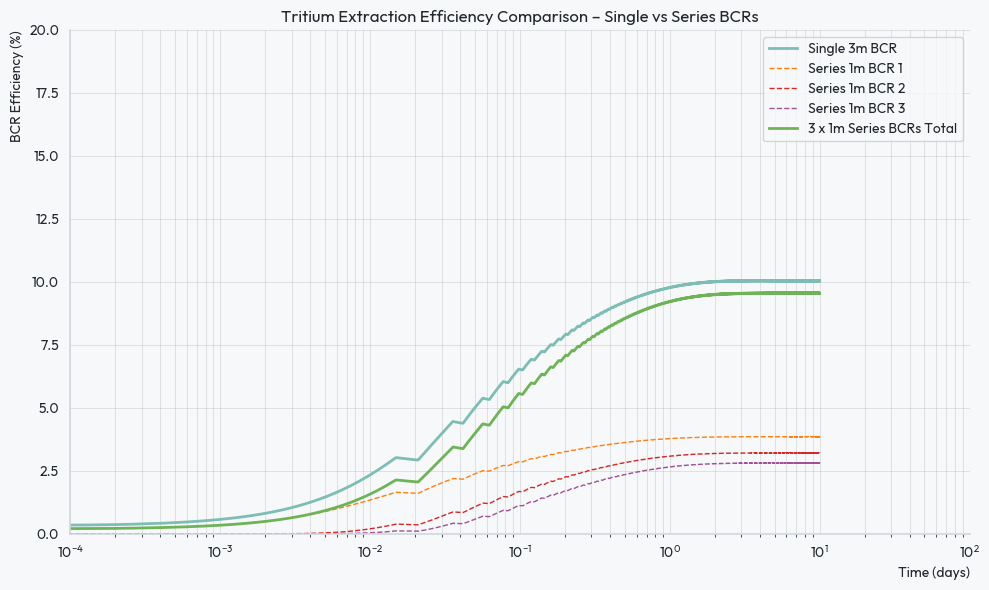

In [11]:
# Load results from each simulation & create plots
import numpy as np
import matplotlib.pyplot as plt
import morethemes as mt
import os

# Load results
single_results = np.load('../results/ARC_single_bcr_results.npz')
series_results = np.load('../results/ARC_series_bcr_results.npz')

# print(list(single_results.keys()))
# print(list(series_results.keys()))

# Extract time (converting seconds to days)
time_single = single_results['scope_3_time'] / (24 * 3600)
time_series = series_results['scope_2_BCR_1_BCR_2_BCR_3_time'] / (24 * 3600)

# Extract efficiency data (converting to %)
# Single 3m BCR
eff_single = single_results['scope_3_data'][0] * 100

# Series 1m BCRs (individual)
eff_series = series_results['scope_2_BCR_1_BCR_2_BCR_3_data'] * 100
eff_series_1 = eff_series[0]
eff_series_2 = eff_series[1]
eff_series_3 = eff_series[2]

# Calculate total cumulative efficiency for the series configuration
# η_total = 1 - (1-η1)(1-η2)(1-η3)
eff_total_series = (1 - (1 - eff_series_1/100) * (1 - eff_series_2/100) * (1 - eff_series_3/100)) * 100

# Create the plot
mt.set_theme("lighter")
fig, ax = plt.subplots(figsize=(10, 6))

# Plot lines to match the style in your image
ax.plot(time_single, eff_single, label='Single 3m BCR', color='#7ebdb4', linewidth=2)
ax.plot(time_series, eff_series_1, label='Series 1m BCR 1', color='tab:orange', linestyle='--', linewidth=1)
ax.plot(time_series, eff_series_2, label='Series 1m BCR 2', color='tab:red', linestyle='--', linewidth=1)
ax.plot(time_series, eff_series_3, label='Series 1m BCR 3', color='#a05195', linestyle='--', linewidth=1)
ax.plot(time_series, eff_total_series, label='3 x 1m Series BCRs Total', color='#6fb358', linewidth=2)

# Formatting
ax.set_xscale('log')
ax.set_xlim(1e-4, 1e2)
ax.set_ylim(0, 20)
ax.set_xlabel('Time (days)', loc='right')
ax.set_ylabel('BCR Efficiency (%)')
ax.set_title('Tritium Extraction Efficiency Comparison – Single vs Series BCRs')
ax.legend()
ax.grid(True, which='both', alpha=0.3)

plt.tight_layout()

# Save plot to plots folder
plots_dir = '../plots'
os.makedirs(plots_dir, exist_ok=True)
plot_filename = 'ARC_single_vs_series_bcr_efficiency_Fig5.png'
plot_path = os.path.join(plots_dir, plot_filename)
plt.savefig(plot_path, dpi=300, bbox_inches='tight')
print(f"Plot saved to: {plot_path}")

plt.show()